In [ ]:
import sys
import os
sys.path.append('model_banks/colorfusion')
from colorfusion_utils import load_colorfusion_model, gencolor_forward, gencolor_feed_data
from PIL import Image
import torch
from io import BytesIO
import base64
import numpy as np
from IPython.display import HTML, display
from crop_magnify import crop_and_magnify
from model_banks.colorfusion.colorfusion_utils import tensor2img
device = torch.device("cuda")


# helper functions
def pil_to_base64(img):
    buffer = BytesIO()
    img.save(buffer, format="PNG")
    return base64.b64encode(buffer.getvalue()).decode()

def display_images_grid(img_list, captions=None, images_per_row=2):
    """Display images in a grid with specified number of images per row."""
    img_pil_list = [Image.fromarray(np.array(img)) for img in img_list]
    if captions is None:
        captions = [""] * len(img_pil_list)
    
    # Create HTML rows
    rows_html = []
    for i in range(0, len(img_pil_list), images_per_row):
        row_images = img_pil_list[i:i+images_per_row]
        row_captions = captions[i:i+images_per_row]
        row_html = ''.join([
            f'<td style="text-align:center; padding:10px;"><img src="data:image/png;base64,{pil_to_base64(image)}" /><br>{caption}</td>' 
            for image, caption in zip(row_images, row_captions)
        ])
        rows_html.append(f'<tr>{row_html}</tr>')
    
    table_html = f'<table>{"".join(rows_html)}</table>'
    display(HTML(table_html))

/home/wyx/miniconda3/envs/gencolor/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/wyx/miniconda3/envs/gencolor/lib/python3.10/site-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


In [2]:
# Load model in float32
fusion_model = load_colorfusion_model(load_path="ckpt/GenColor_fusion/base.pth", in_chans=6, device=device, model_type='base')
fusion_model = fusion_model.to(torch.float32).eval()

# Compile for max speed (PyTorch 2.0+)
# if hasattr(torch, 'compile'):
#     fusion_model = torch.compile(fusion_model, mode='reduce-overhead')

/home/wyx/miniconda3/envs/gencolor/lib/python3.10/site-packages/torch/functional.py:513: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3609.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/wyx_disk2/codes/GenColor/GenColor/model_banks/colorfusion/colorfusion_utils.py:41: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless the

In [3]:
input_img = Image.open('example/adobe5k_sample258.png')
color_refs = {
    'gpt5_1': Image.open('example/adobe5k_sample258_gpt5.1.png').resize(input_img.size),
    'nanobanana': Image.open('example/adobe5k_sample258_nanobanana.png').resize(input_img.size),
    'nanobananna_pro': Image.open('example/adobe5k_sample258_nanobanana pro.png').resize(input_img.size)
}


# Process each color reference and generate fusion results
fusions = {}
for name, color_ref in color_refs.items():
    # Prepare data in float32
    data_tensor = gencolor_feed_data(input_img, color_ref, device=device)
    for key, value in data_tensor.items():
        if isinstance(value, torch.Tensor):
            data_tensor[key] = value.to(torch.float32)
    
    # Generate fusion
    with torch.no_grad():
        robust_fusion_tensor = gencolor_forward(fusion_model, data_tensor, return_np=False)
    fusions[name] = Image.fromarray(tensor2img(robust_fusion_tensor, rgb2bgr=False)).resize(input_img.size)

Input,Color Reference GPT5.1,Fusion GPT5.1

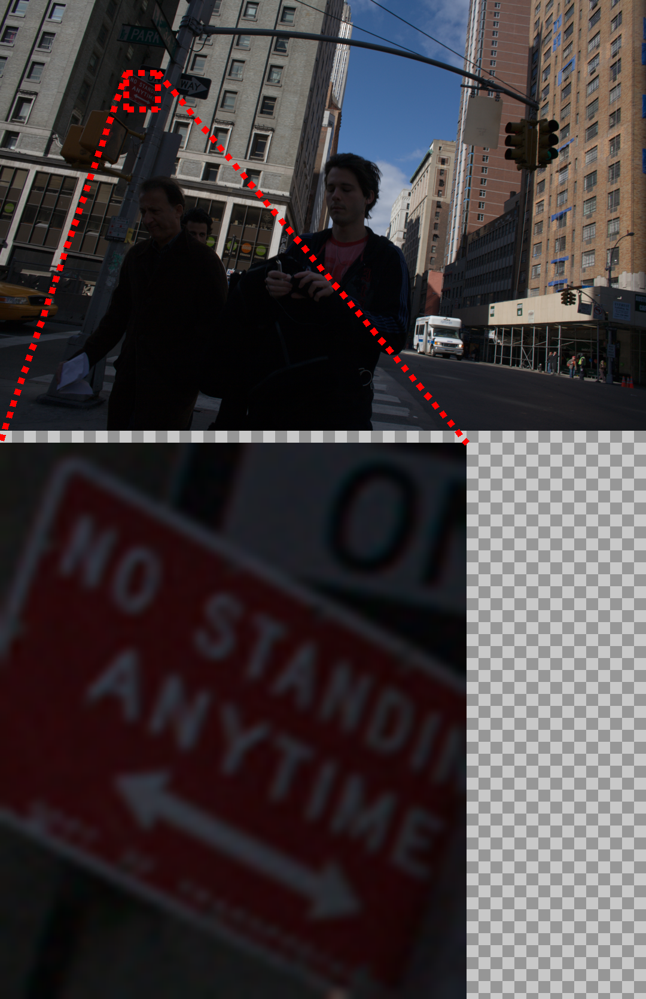
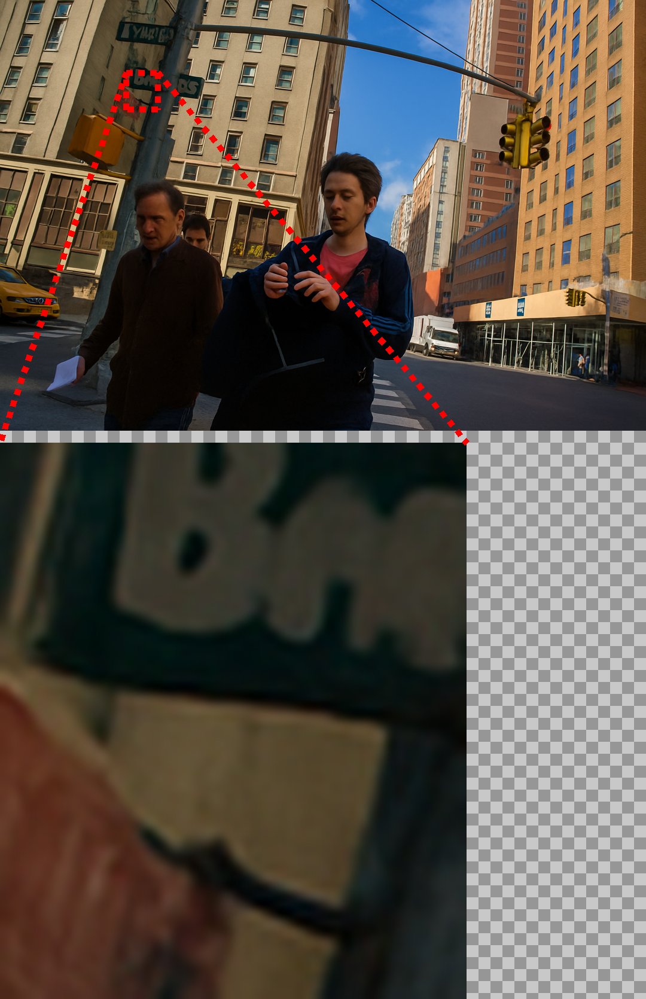
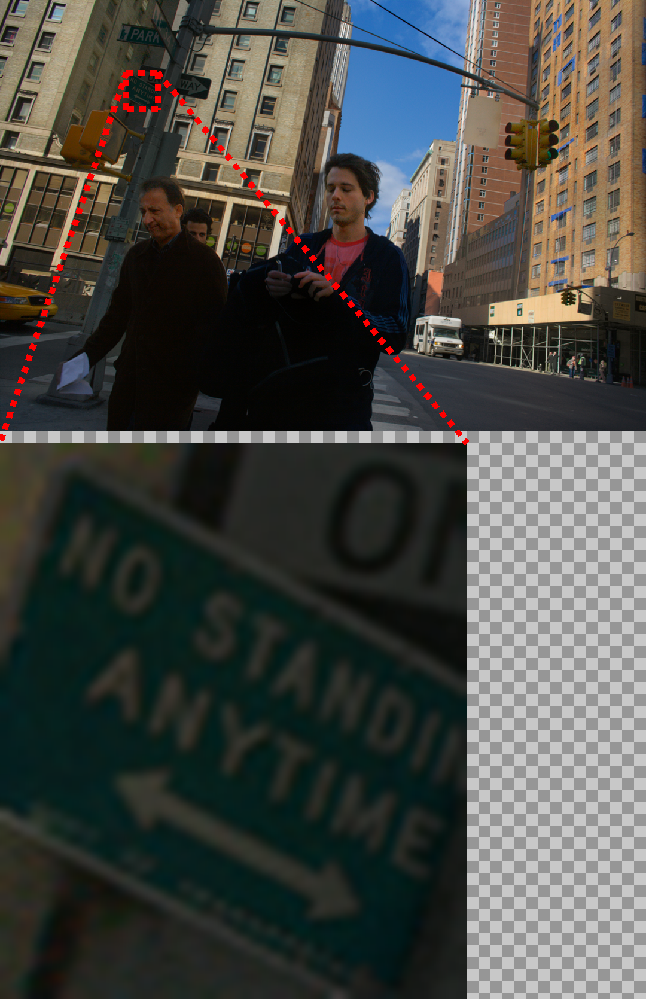

Input,Color Reference NanoBanana,Fusion NanoBanana

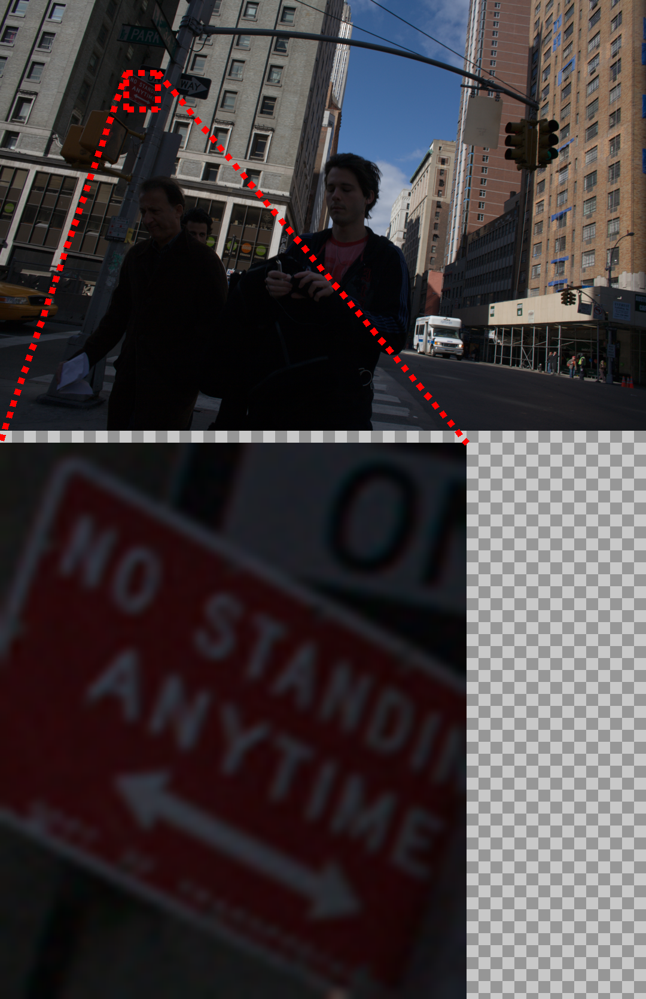
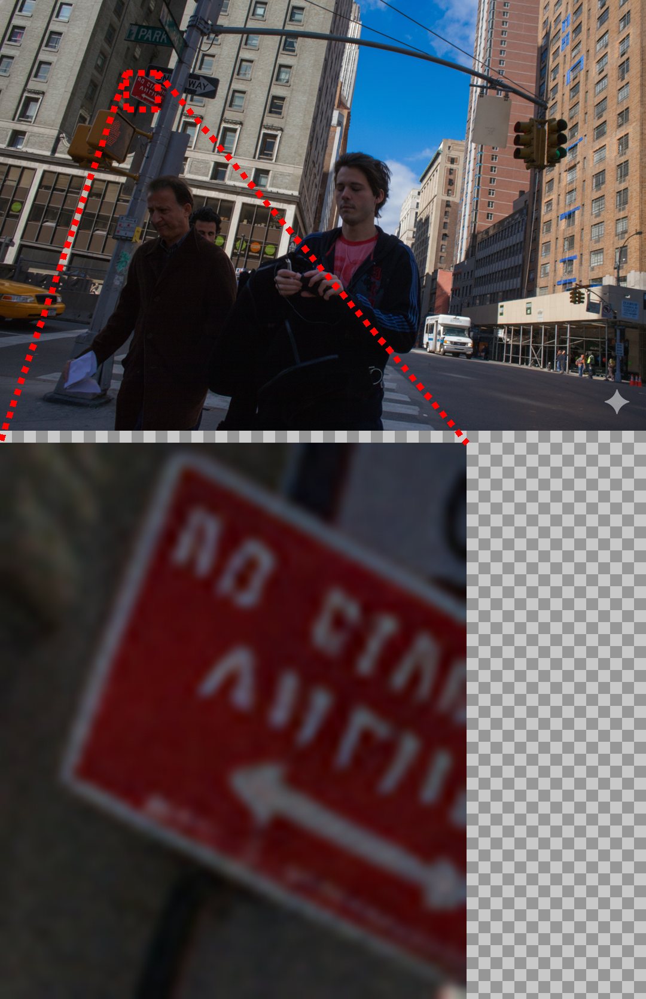
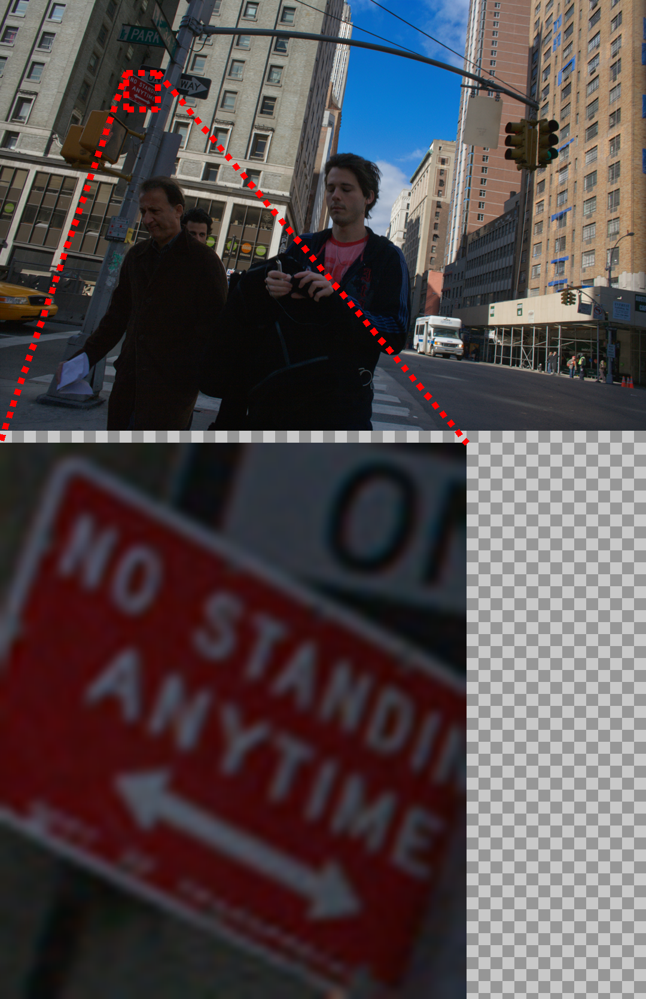

Input,Color Reference NanoBanana Pro,Fusion NanoBanana Pro

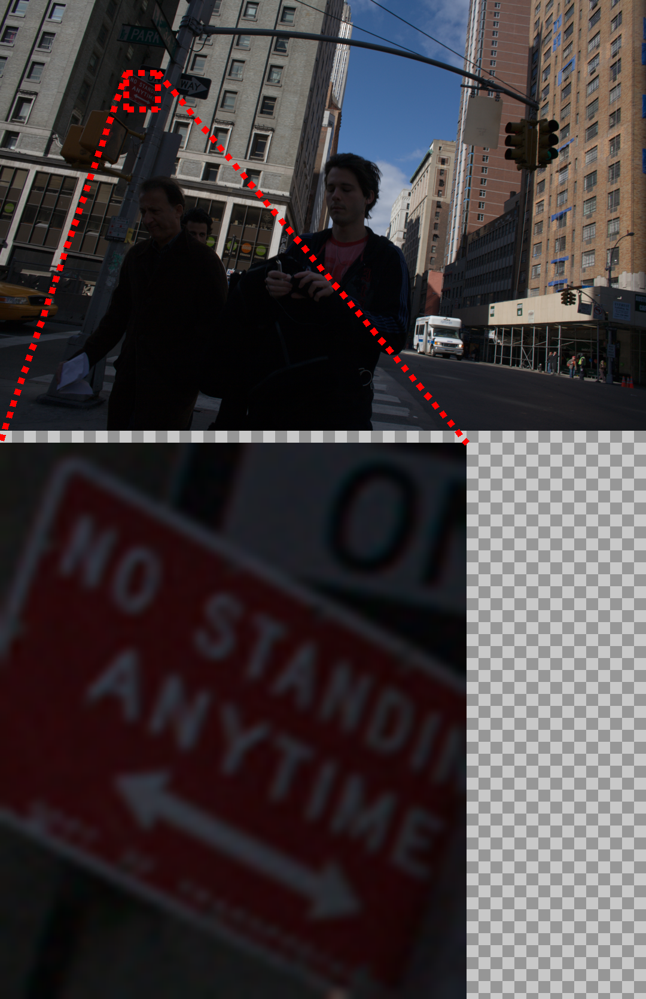
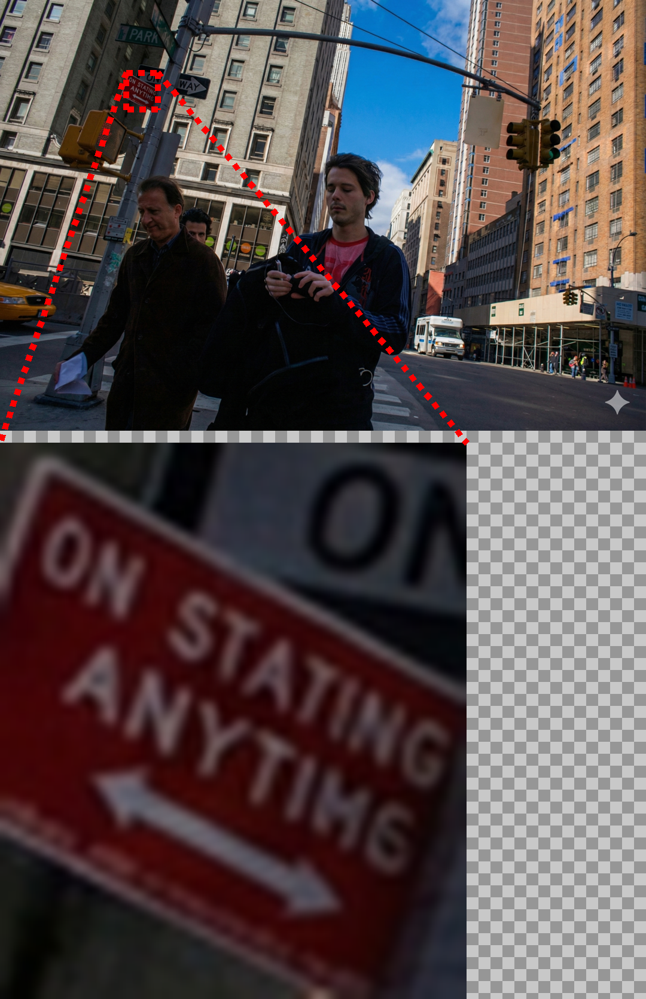
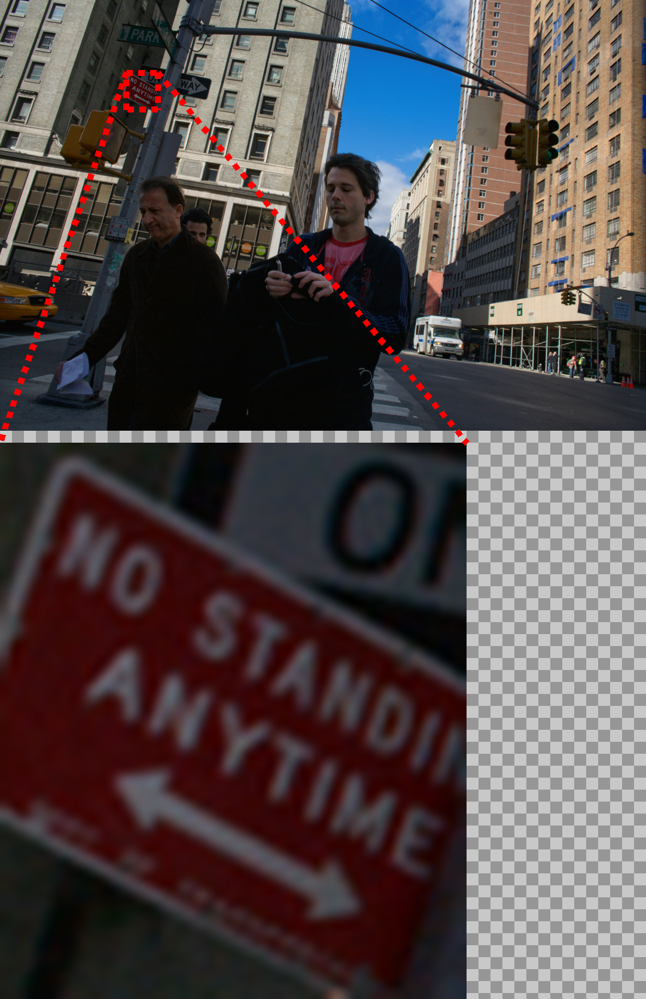

Input,Fusion GPT5.1,Fusion NanoBanana,Fusion NanoBanana Pro

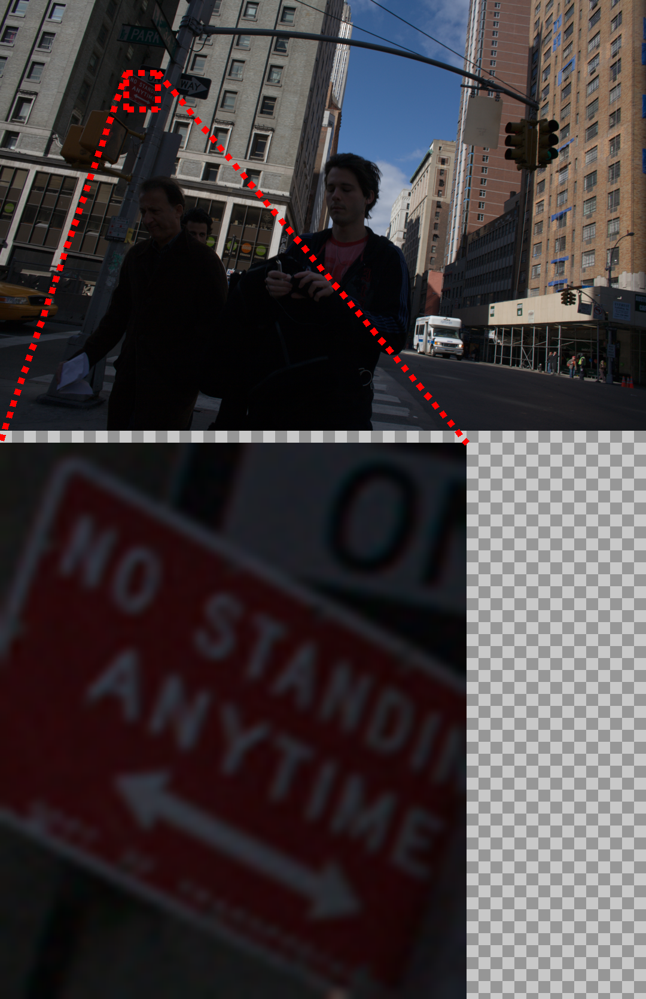
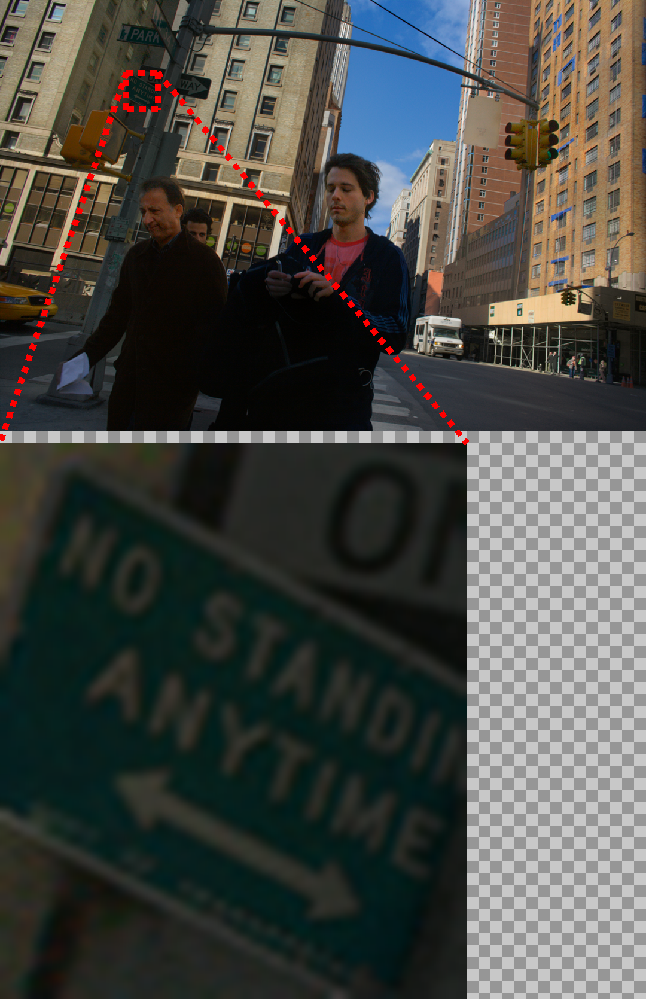
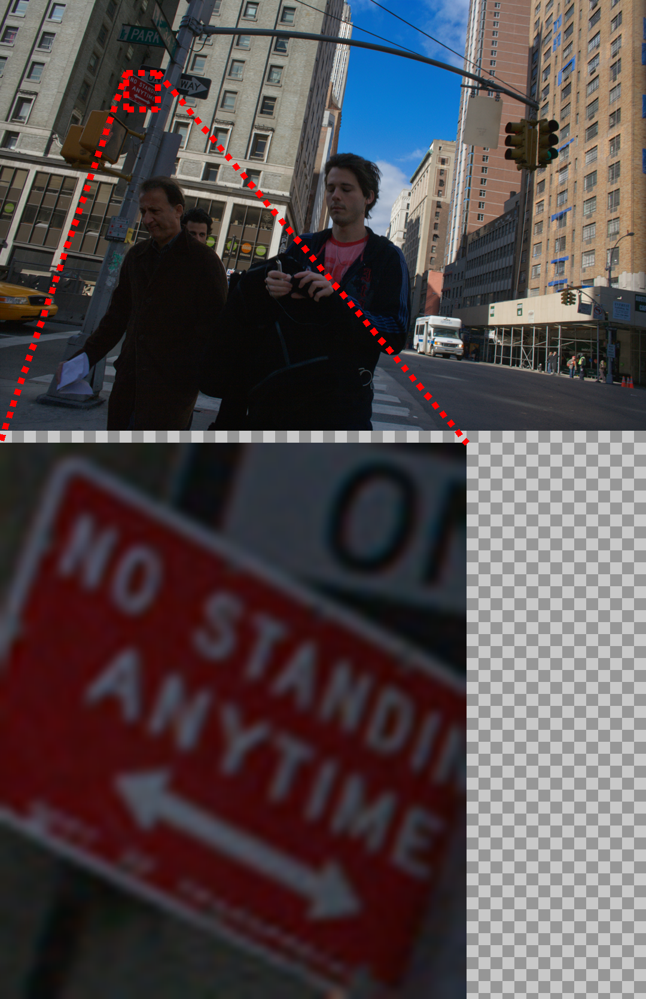
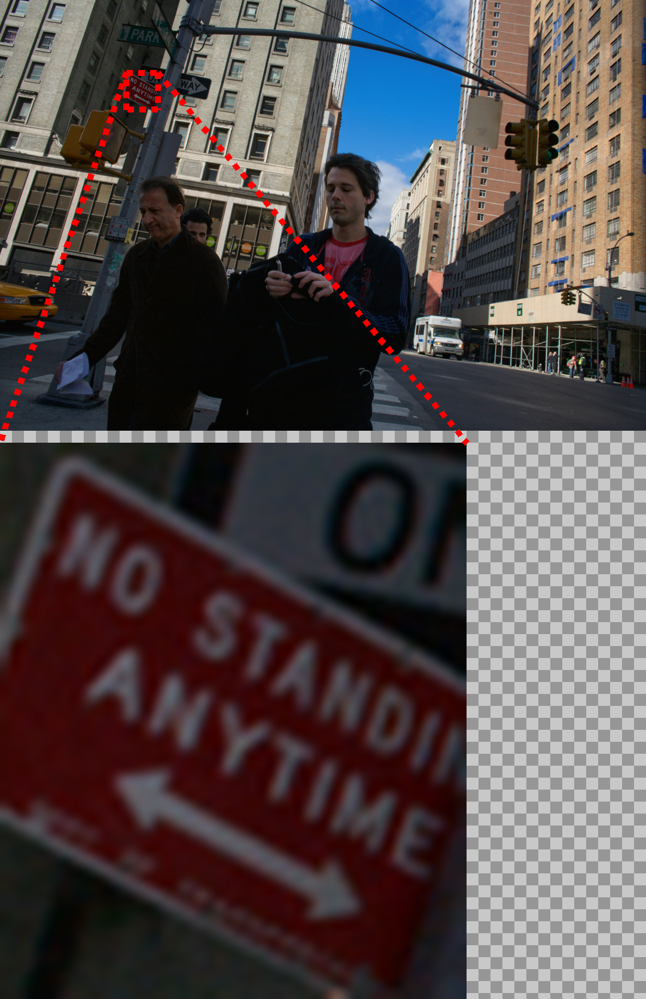

In [4]:
top_left = (211, 121)
bottom_right = (263, 183)
crop_params = {'magnify_scale': 15.0, 'box_width': 10, 'concat_direction': 'vertical'}

# Process input image
_, _, input_combined = crop_and_magnify(input_img, top_left, bottom_right, **crop_params)

# Process color references and fusions
color_combined = {}
fusion_combined = {}
for name in color_refs.keys():
    _, _, color_combined[name] = crop_and_magnify(color_refs[name], top_left, bottom_right, **crop_params)
    _, _, fusion_combined[name] = crop_and_magnify(fusions[name], top_left, bottom_right, **crop_params)

# Display the combined views
display_images_grid([input_combined, color_combined['gpt5_1'], fusion_combined['gpt5_1']], 
                    ['Input', 'Color Reference GPT5.1', 'Fusion GPT5.1'], 
                    images_per_row=3)
display_images_grid([input_combined, color_combined['nanobanana'], fusion_combined['nanobanana']], 
                    ['Input', 'Color Reference NanoBanana', 'Fusion NanoBanana'], 
                    images_per_row=3)
display_images_grid([input_combined, color_combined['nanobananna_pro'], fusion_combined['nanobananna_pro']], 
                    ['Input', 'Color Reference NanoBanana Pro', 'Fusion NanoBanana Pro'], 
                    images_per_row=3)
display_images_grid([input_combined, fusion_combined['gpt5_1'], fusion_combined['nanobanana'], fusion_combined['nanobananna_pro']], 
                    ['Input', 'Fusion GPT5.1', 'Fusion NanoBanana', 'Fusion NanoBanana Pro'], 
                    images_per_row=4)